# 0. Data Loading

In [1]:
import os
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import random
from collections import defaultdict
from tqdm import tqdm
import time


In [2]:
# Load the images and captions dataset
!wget https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_Dataset.zip
!unzip Flickr8k_Dataset.zip

!wget https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_text.zip
!unzip Flickr8k_text.zip

Streaming output truncated to the last 5000 lines.
  inflating: __MACOSX/Flicker8k_Dataset/._3430607596_7e4f74e3ff.jpg  
  inflating: Flicker8k_Dataset/343073813_df822aceac.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._343073813_df822aceac.jpg  
  inflating: Flicker8k_Dataset/3430779304_43a2146f4b.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430779304_43a2146f4b.jpg  
  inflating: Flicker8k_Dataset/3430782104_34da558eba.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430782104_34da558eba.jpg  
  inflating: Flicker8k_Dataset/3431101934_99a6c55914.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3431101934_99a6c55914.jpg  
  inflating: Flicker8k_Dataset/3431121650_056db85987.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3431121650_056db85987.jpg  
  inflating: Flicker8k_Dataset/3431194126_ca78f5fde6.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3431194126_ca78f5fde6.jpg  
  inflating: Flicker8k_Dataset/3431261634_c73360406a.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._343126

# 1. Data Preparation

## 1.1. Load the captions

In [3]:
# set the image folder
image_folder = '/content/Flicker8k_Dataset'

In [4]:
# initialize a dictionary to store captions
captions_map = defaultdict(list)

# add [start] and [end] to each caption
SEQ_START = '[start]'
SEQ_END = '[end]'

# open the caption file and read all lines
with open('/content/Flickr8k.token.txt') as file:
    lines = file.readlines()
    for line in lines:
        data = line.split('\t')
        image_id = data[0].split('#')[0]
        caption = SEQ_START + ' ' + data[1].strip() + ' ' + SEQ_END
        if not os.path.exists(os.path.join(image_folder, image_id)):
            continue
        # add the caption to the list of captions for the corresponding image ID
        captions_map[image_id].append(caption)

In [5]:
# get the number of unique images with valid captions
len(list(captions_map.keys()))

8091

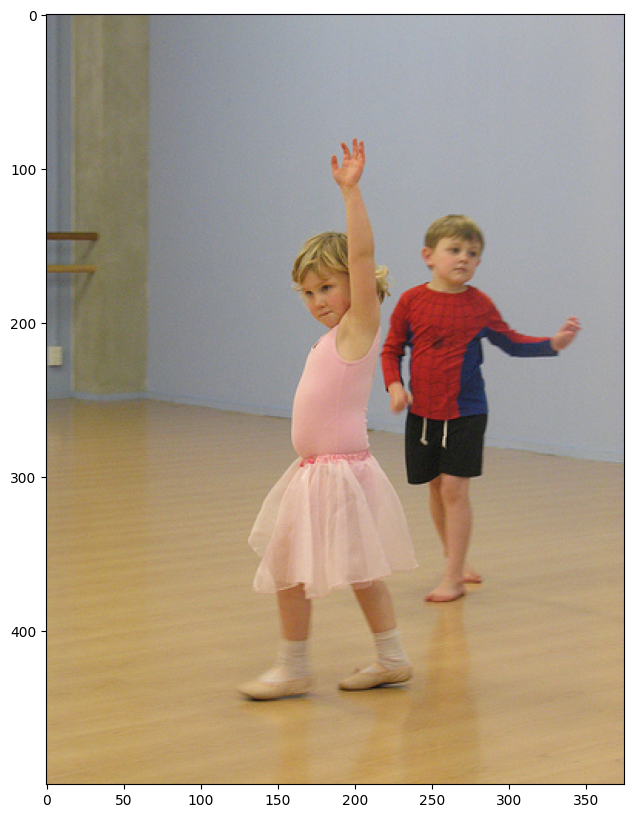

Caption 1: [start] A girl in a tutu and a boy in a costume in a dancefloor . [end]
Caption 2: [start] A little girl in a pink tutu gets ready for ballet dancing , a boy in a Spider-Man shirt behind . [end]
Caption 3: [start] a young girl wearing a pink tutu dancing with another young boy in the background . [end]
Caption 4: [start] A young girl wearing a tutu dances in a large room . [end]
Caption 5: [start] Two children are in costume in a dance studio . [end]




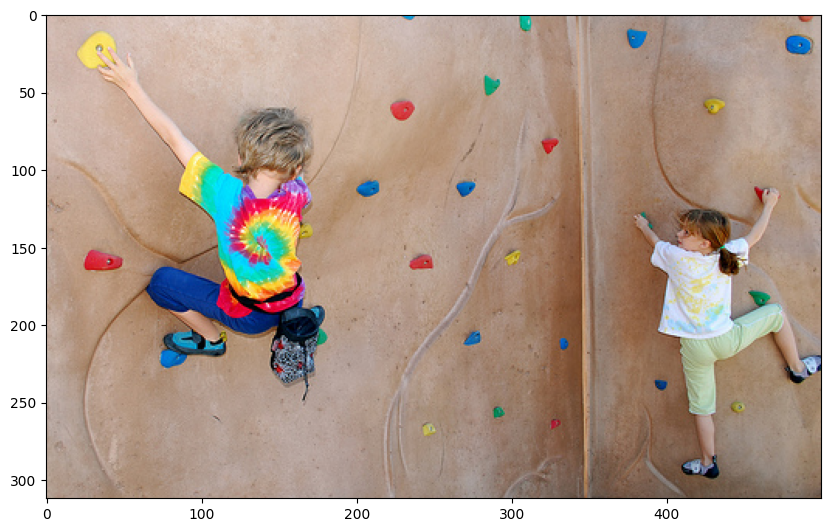

Caption 1: [start] A child in a tie dye shirt and one in a white shirt are on a climbing wall . [end]
Caption 2: [start] A child in a Tye-dyed shirt is climbing a rock wall with another child . [end]
Caption 3: [start] The children take a crack at rock climbing . [end]
Caption 4: [start] Two children climbing a rock climbing wall . [end]
Caption 5: [start] Two kids climb a rock wall . [end]




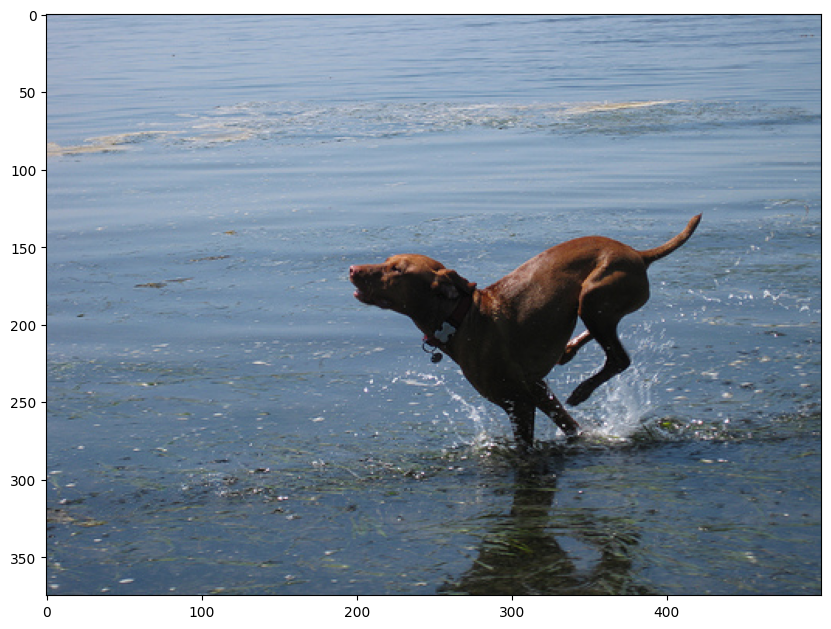

Caption 1: [start] A brown dog is running in the water by the beach . [end]
Caption 2: [start] A brown dog jumps in the ocean . [end]
Caption 3: [start] A brown dog runs down a beach . [end]
Caption 4: [start] A brown dog wearing a collar is running through some water . [end]
Caption 5: [start] A dog running through the water . [end]




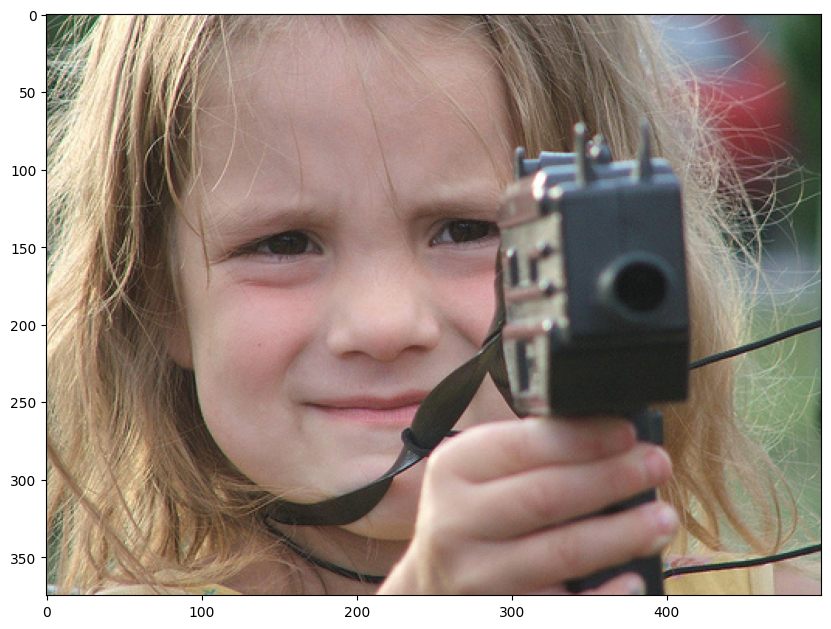

Caption 1: [start] A little girl is holding a cine camera in front of her face . [end]
Caption 2: [start] A young girl is looking through an old fashioned video camera . [end]
Caption 3: [start] A young girl steadies her aim with a camera [end]
Caption 4: [start] Girl with rosy cheeks and lips holding black toy gun . [end]
Caption 5: [start] There is a kid with a gun . [end]




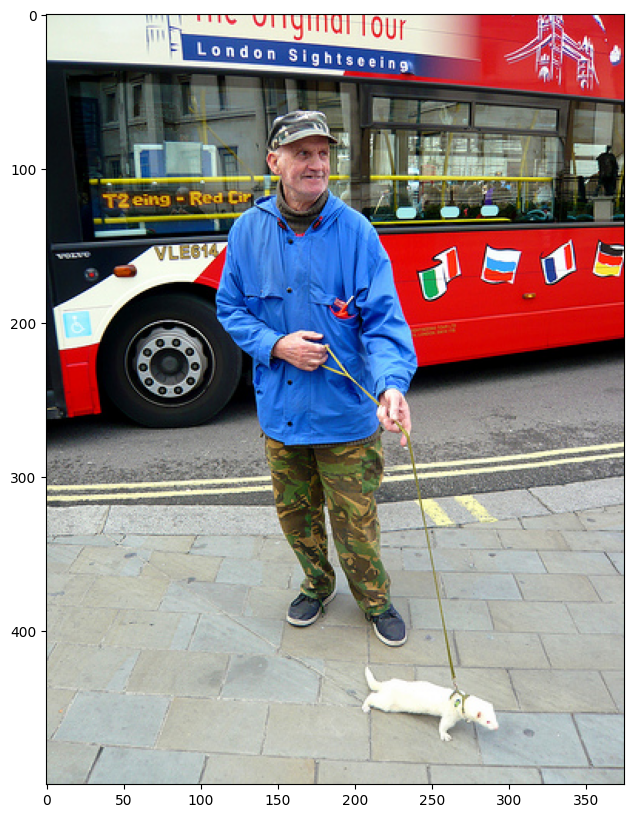

Caption 1: [start] A man in a blue coat walks a small white animal as a buss passes in the background . [end]
Caption 2: [start] A man in a blue jacket holding a small white animal on a leash [end]
Caption 3: [start] A man in a blue jacket walks a small , white animal while a London Sightseeing bus drives behind him . [end]
Caption 4: [start] A man is on a sidewalk with a small animal on a leash . [end]
Caption 5: [start] An old man walking a ferrett through the street on a leash . [end]




In [6]:
# look at the first 3 images from the image folder with their captions
top_images = os.listdir(image_folder)[:5]

for img in top_images:
    if img in captions_map:

        plt.figure(figsize=(10, 10))
        plt.imshow(plt.imread(os.path.join(image_folder, img)))
        plt.show()

        for i, caption in enumerate(captions_map[img], 1):
            print(f"Caption {i}: {caption}")
        print("\n" + "="*80 + "\n")

In [7]:
# initialize empty lists to store all captions and corresponding image paths
all_captions = []
all_image_paths = []

# loop through each image ID in the captions dictionary
for image_id in captions_map:
    all_captions.extend(captions_map[image_id])
    all_image_paths.extend([os.path.join(image_folder, image_id)] * len(captions_map[image_id]))

In [8]:
# show the first 5 captions from the all_captions list
all_captions[:5]

['[start] A child in a pink dress is climbing up a set of stairs in an entry way . [end]',
 '[start] A girl going into a wooden building . [end]',
 '[start] A little girl climbing into a wooden playhouse . [end]',
 '[start] A little girl climbing the stairs to her playhouse . [end]',
 '[start] A little girl in a pink dress going into a wooden cabin . [end]']

In [9]:
# show the first 5 image paths from the all_image_path list
all_image_paths[:5]

['/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg']

## 1.2. Caption Standardization and Tokenization

In [10]:
# creating a TensorFlow Dataset from captions
caption_dataset = tf.data.Dataset.from_tensor_slices(all_captions)
for caption in caption_dataset.take(5):
    print(caption)

tf.Tensor(b'[start] A child in a pink dress is climbing up a set of stairs in an entry way . [end]', shape=(), dtype=string)
tf.Tensor(b'[start] A girl going into a wooden building . [end]', shape=(), dtype=string)
tf.Tensor(b'[start] A little girl climbing into a wooden playhouse . [end]', shape=(), dtype=string)
tf.Tensor(b'[start] A little girl climbing the stairs to her playhouse . [end]', shape=(), dtype=string)
tf.Tensor(b'[start] A little girl in a pink dress going into a wooden cabin . [end]', shape=(), dtype=string)


In [11]:
# standardizaiton, convert to lowercase and remove punctuation
def standardize(inputs):
    inputs = tf.strings.lower(inputs)
    return tf.strings.regex_replace(inputs, r"!\"#$%&\(\)\*\+.,-/:;=?@\[\\\]^_`{|}~", "")

In [12]:
# parameters for tokenizer
MAX_LENGTH = 50
VOCAB_SIZE = 7000

# creating the tokenizer
tokenizer = tf.keras.layers.TextVectorization(
    max_tokens=VOCAB_SIZE,
    standardize=standardize,
    output_sequence_length=MAX_LENGTH)

# learn the vocabulary from the caption data
tokenizer.adapt(caption_dataset)

In [13]:
# get the size of the vocabulary
len(tokenizer.get_vocabulary())

7000

In [14]:
# converting captions to vector sequences
# converts the captions in caption_dataset into sequences of integers using the tokenizer
caption_vectors = caption_dataset.map(lambda x: tokenizer(x))

In [15]:
# get to see a sample tokenized caption
for cap in caption_vectors.take(1):
    print(cap)

tf.Tensor(
[  3   2  45   6   2  93 173   9 122  56   2 400  14 397   6  31   1 698
   5   4   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
   0   0   0   0   0   0   0   0   0   0   0   0   0   0], shape=(50,), dtype=int64)


In [16]:
# create 2 mappings
word_to_index = tf.keras.layers.StringLookup(mask_token="", vocabulary=tokenizer.get_vocabulary())
index_to_word = tf.keras.layers.StringLookup(mask_token="", vocabulary=tokenizer.get_vocabulary(), invert=True)

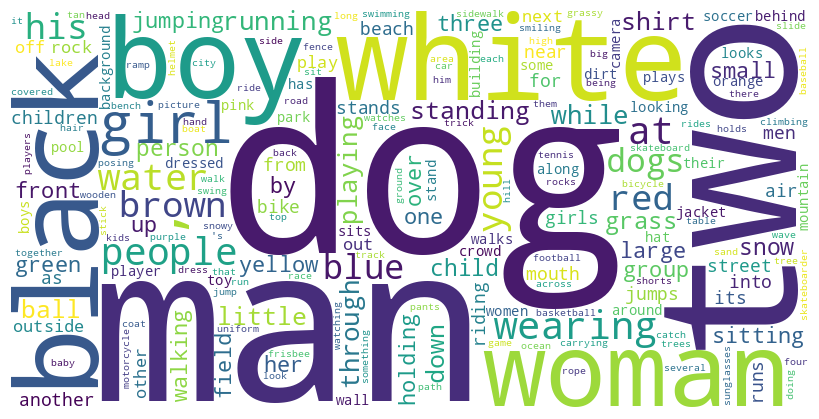

In [17]:
from collections import Counter
import matplotlib.pyplot as plt
from wordcloud import WordCloud

# Initialize a Counter object to count word frequencies
word_freq = Counter()
stop_words_1 = {'[start]', '[end]','.'}
stop_words_2 = {'[start]', '[end]','.','and','a','in','on','the','with','is','are','to','an','of'}

# Process each caption
for captions_list in captions_map.values():
    for caption in captions_list:
        # Tokenize and update counts (assuming standardize function is defined)
        tokens = standardize(caption).numpy().decode('utf-8').split()
        word_freq.update(word for word in tokens if word not in stop_words_2)

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400, background_color ='white').generate_from_frequencies(word_freq)

# Plotting the WordCloud image
plt.figure(figsize=(8, 8), facecolor=None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad=0)

plt.show()


## 1.3 Image Feature Extraction

In [18]:
# VGG19 model for feature extraction
vgg_model = tf.keras.applications.vgg19.VGG19(include_top=False, weights='imagenet')

input = vgg_model.input
output = vgg_model.layers[-1].output
print(output.shape)
vgg_model = tf.keras.Model(input, output)

80134624/80134624 [==============================] - 5s 0us/step
(None, None, None, 512)


In [19]:
vgg_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, None, None, 3)]   0         
                                                                 
 block1_conv1 (Conv2D)       (None, None, None, 64)    1792      
                                                                 
 block1_conv2 (Conv2D)       (None, None, None, 64)    36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, None, None, 64)    0         
                                                                 
 block2_conv1 (Conv2D)       (None, None, None, 128)   73856     
                                                                 
 block2_conv2 (Conv2D)       (None, None, None, 128)   147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, None, None, 128)   0     

In [20]:
# define a function preprocessing images to match the input requirements of VGG19
def load_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.io.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, (224, 224))
    img = tf.keras.applications.vgg19.preprocess_input(img)
    return img, image_path

In [21]:
# Get unique images
unique_paths = sorted(set(all_image_paths))

In [22]:
# test, get the shape of the output
image_dataset = tf.data.Dataset.from_tensor_slices(unique_paths)
image_dataset = image_dataset.map(load_image, num_parallel_calls=tf.data.AUTOTUNE).batch(16)
for image, path in tqdm(image_dataset.take(1)):
    features = vgg_model(image)
    print(features.shape)

100%|██████████| 1/1 [00:05<00:00,  5.89s/it]

(16, 7, 7, 512)


In [23]:
# batch feature extraction and storage
image_dataset = tf.data.Dataset.from_tensor_slices(unique_paths)
image_dataset = image_dataset.map(load_image, num_parallel_calls=tf.data.AUTOTUNE).batch(16)

for image, path in tqdm(image_dataset):

    # batch_features = (16, 7, 7, 512) for VGG19
    features = vgg_model(image)

    # after reshaping, batch_features shape == (16, 49, 512) for VGG19
    features = tf.reshape(features,
                                (features.shape[0], -1, features.shape[3]))

    # store the features to a numpy file
    for bf, p in zip(features, path):
        feature_path = p.numpy().decode("utf-8")
        np.save(feature_path, bf.numpy())


100%|██████████| 506/506 [01:06<00:00,  7.62it/s]


## 1.4 Data Splitting to training and validation set

In [24]:
image_to_caption_vectors = defaultdict(list)
for image_path, caption in zip(all_image_paths, caption_vectors):
    image_to_caption_vectors[image_path].append(caption)

In [25]:
image_to_caption_vectors[all_image_paths[0]]

[<tf.Tensor: shape=(50,), dtype=int64, numpy=
 array([  3,   2,  45,   6,   2,  93, 173,   9, 122,  56,   2, 400,  14,
        397,   6,  31,   1, 698,   5,   4,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0])>,
 <tf.Tensor: shape=(50,), dtype=int64, numpy=
 array([  3,   2,  21, 318,  67,   2, 197, 120,   5,   4,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0])>,
 <tf.Tensor: shape=(50,), dtype=int64, numpy=
 array([   3,    2,   43,   21,  122,   67,    2,  197, 2510,    5,    4,
           0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
           0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
           0,    0,    0,    0,    0,    0,    0,    0,    0,    0,   

In [26]:
# create training and validation sets using an 80-20 split randomly

seed = 691
random.seed(seed)

random.shuffle(unique_paths)
slice_index = int(len(unique_paths) * 0.8)
train_paths, val_paths = unique_paths[:slice_index], unique_paths[slice_index:]

In [27]:
image_train_paths =[]
caption_train = []
cnt = 0
for path in train_paths:
    caption_len = len(image_to_caption_vectors[path])
    image_train_paths.extend([path] * caption_len)
    caption_train.extend(image_to_caption_vectors[path])

image_val_paths = []
caption_val = []
for path in val_paths:
    caption_len = len(image_to_caption_vectors[path])
    image_val_paths.extend([path] * caption_len)
    caption_val.extend(image_to_caption_vectors[path])

len(image_train_paths), len(caption_train), len(image_val_paths), len(caption_val)

(32360, 32360, 8095, 8095)

In [28]:
image_train_paths[:5]

['/content/Flicker8k_Dataset/2528489543_546c1ca81f.jpg',
 '/content/Flicker8k_Dataset/2528489543_546c1ca81f.jpg',
 '/content/Flicker8k_Dataset/2528489543_546c1ca81f.jpg',
 '/content/Flicker8k_Dataset/2528489543_546c1ca81f.jpg',
 '/content/Flicker8k_Dataset/2528489543_546c1ca81f.jpg']

## 1.5 Optimized TensorFlow Data Preparation

In [29]:
# Load the numpy files (pre-extracted features)
def map_func(image_path, caption):
    img_tensor = np.load(image_path.decode('utf-8') + '.npy')
    return img_tensor, caption

In [30]:
# set the batch size and the buffer size parameters
BATCH_SIZE = 64
BUFFER_SIZE = 1000

In [31]:
# create the train dataset
train_dataset = tf.data.Dataset.from_tensor_slices((image_train_paths, caption_train))

# use map to load the numpy files in parallel
train_dataset = train_dataset.map(lambda item1, item2: tf.numpy_function(map_func, [item1, item2], [tf.float32, tf.int64]),
                      num_parallel_calls=tf.data.AUTOTUNE)

# shuffle, batch, and prefetch
train_dataset = train_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE).prefetch(buffer_size=tf.data.AUTOTUNE)

# create the validation dataset
val_dataset = tf.data.Dataset.from_tensor_slices((image_val_paths, caption_val))

val_dataset = val_dataset.map(
    lambda item1, item2: tf.numpy_function(map_func, [item1, item2], [tf.float32, tf.int64]),
    num_parallel_calls=tf.data.AUTOTUNE)

val_dataset = val_dataset.batch(BATCH_SIZE).prefetch(buffer_size=tf.data.AUTOTUNE)


In [32]:
for img, cap in train_dataset.take(1):
    print(img)
    print(cap)

tf.Tensor(
[[[1.3734491e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
   3.9467905e+00 0.0000000e+00]
  [3.3627880e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
   8.8858852e+00 0.0000000e+00]
  [6.4951591e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
   1.2902165e+01 0.0000000e+00]
  ...
  [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
   0.0000000e+00 0.0000000e+00]
  [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
   0.0000000e+00 0.0000000e+00]
  [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
   0.0000000e+00 0.0000000e+00]]

 [[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
   0.0000000e+00 0.0000000e+00]
  [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
   0.0000000e+00 6.8914086e-02]
  [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
   0.0000000e+00 1.9524160e+01]
  ...
  [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
   1.4770792e+01 0.0000000e+00]
  [0.0000000e+00 0.000000

# 2. Model Building

## 2.1 Mask

In [33]:
# create_look_ahead_mask
def create_look_ahead_mask(sequence_length):
    # creating a matrix of 1s
    mask = tf.linalg.band_part(tf.ones((1, sequence_length, sequence_length)), -1, 0)
    #return the lower triangular part of the matrix
    return mask

# create padding mask
def create_padding_mask(decoder_token_ids):
    # identifying tokens with value 0
    seq = 1 - tf.cast(tf.math.equal(decoder_token_ids, 0), tf.float32)
    # expands the dimensions of the mask for compatibility with the attention logits
    return seq[:, tf.newaxis, :]

## 2.2 Positional Encoding

In [34]:
def get_angles(pos, i, d_model):
    angle_rates = 1 / np.power(10000, (2 * (i//2)) / np.float32(d_model))
    return pos * angle_rates

In [35]:
# 2 version of positional encoding
# 1 for Encoder (grid features)
# 1 for Decoder (sequence)

In [36]:
# 1D positional encoding for decoder
def positional_encoding_1d(position, D):
    angle_rads = get_angles(np.arange(position)[:, np.newaxis],  # column vector
                            np.arange(D)[np.newaxis, :],  # row vector
                            D)

    # sine function to even indices
    angle_rads[:, 0::2] = np.sin(angle_rads[:, 0::2])

    # cosine function to odd indices
    angle_rads[:, 1::2] = np.cos(angle_rads[:, 1::2])

    pos_encoding = angle_rads[np.newaxis, ...]

    return tf.cast(pos_encoding, dtype=tf.float32)

In [37]:
# 2D positional encoding for encoder
def positional_encoding_2d(row, col, D):
    assert D % 2 == 0

    # first D/2 encode row embedding and second D/2 encode column embedding
    row_pos = np.repeat(np.arange(row), col)[:, np.newaxis]
    col_pos = np.repeat(np.expand_dims(np.arange(col), 0), row, axis=0).reshape(-1, 1)

    angle_rads_row = get_angles(row_pos,
                                np.arange(D // 2)[np.newaxis, :],
                                D // 2)
    angle_rads_col = get_angles(col_pos,
                                np.arange(D // 2)[np.newaxis, :],
                                D // 2)

    # apply sin and cos to odd and even indices resp
    angle_rads_row[:, 0::2] = np.sin(angle_rads_row[:, 0::2])
    angle_rads_row[:, 1::2] = np.cos(angle_rads_row[:, 1::2])
    angle_rads_col[:, 0::2] = np.sin(angle_rads_col[:, 0::2])
    angle_rads_col[:, 1::2] = np.cos(angle_rads_col[:, 1::2])

    pos_encoding = np.concatenate([angle_rads_row, angle_rads_col], axis=1)[np.newaxis, ...]

    return tf.cast(pos_encoding, dtype=tf.float32)

## 2.3 Point-wise Feed Forward Network

In [38]:
# process the output of the attention layers, introduce additional non-linearity

def point_wise_feed_forward_network(
    emb_dim,  # Input/output dimensionality (or Embedding dim)
    fc_dim  # Inner-layer dimensionality (or FC dim)
):

    # returns a Sequential model consisting of a series of layers
    return tf.keras.Sequential([
        # transforms the input to the inner-layer dimensionality
        # Shape (batch_size, seq_len, fc_dim)
        tf.keras.layers.Dense(fc_dim, activation='relu'),
        # brings the dimension back to the original embedding dimension
        tf.keras.layers.Dense(emb_dim)
    ])


## 2.4 Encoder

In [39]:
class EncoderBlock(tf.keras.layers.Layer):

    # initializing parameters
    def __init__(self,
                 emb_dim,
                 num_heads,
                 fc_dim,
                 dropout_rate=0.1,
                 layernorm_eps=1e-6):
        super(EncoderBlock, self).__init__()

        # MultiHeadAttention layer setup
        self.mha = tf.keras.layers.MultiHeadAttention(num_heads=num_heads,
                                                      key_dim=emb_dim,
                                                      dropout=dropout_rate)

        # point-wise feed forward network initialization
        self.ffn = point_wise_feed_forward_network(emb_dim=emb_dim,
                                                   fc_dim=fc_dim)

        # layer normalization to stabilize the outputs of each sub-layer, a small epsilon for numerical stability
        self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=layernorm_eps)
        self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=layernorm_eps)

        # dropout layer to reduce overfitting
        self.dropout1 = tf.keras.layers.Dropout(dropout_rate)

    # process the input through one encoder block
    def call(self, x, training, mask):

        # apply MultiHeadAttention on the input
        attn_output = self.mha(query=x, key=x, value=x,
                               training=training, attention_mask=mask)

        # Add and normalize the output from the MultiHeadAttention layer
        # (batch_size, input_seq_len, fully_connected_dim)
        out1 = self.layernorm1(attn_output + x, training=training)

        # apply the feed forward network
        ffn_output = self.ffn(out1, training=training)

        # apply dropout to the output of the feed forward network
        ffn_output = self.dropout1(ffn_output, training=training)

        # add and normalize the output from the feed forward network
        encoder_layer_out = self.layernorm2(ffn_output + out1, training=training)

        return encoder_layer_out

In [40]:
class Encoder(tf.keras.layers.Layer):
    def __init__(self,
                 *,
                 num_layers,
                 emb_dim,  # input/output dimensionality (or Embedding dim)
                 num_heads,
                 fc_dim,  # inner-layer dimensionality (or FC dim)
                 row_size, col_size,    # shape of grid features
                 dropout_rate=0.1,
                 layernorm_eps=1e-6):
        super().__init__()

        # set embedding dimension and number of layers
        self.emb_dim = emb_dim
        self.num_layers = num_layers

        # dense layer for embedding, with ReLU activation function
        self.embedding = tf.keras.layers.Dense(emb_dim, activation='relu')

        # 2D positional encoding with specified row and column sizes
        self.pos_encoding = positional_encoding_2d(row_size, col_size, emb_dim)

        # encoder layers, multiple EncoderBlocks
        self.enc_layers = [EncoderBlock(emb_dim=emb_dim,
                                        num_heads=num_heads,
                                        fc_dim=fc_dim,
                                        dropout_rate=dropout_rate,
                                        layernorm_eps=layernorm_eps)
            for _ in range(num_layers)]

        # dropout layer for the encoder
        self.dropout = tf.keras.layers.Dropout(dropout_rate)


    # process the input through the entire encoder
    def call(self, x, training, mask=None):
        seq_len = tf.shape(x)[1]

        # embedding to the input
        x = self.embedding(x)

        # positional encoding to the embedded input
        x += self.pos_encoding[:, :seq_len, :]

        # dropout to the input
        x = self.dropout(x, training=training)

        # pass the input through each encoder block sequentially
        for i in range(self.num_layers):
            x = self.enc_layers[i](x, training, mask)

        return x  # output shape: (batch_size, input_seq_len, emb_dim)


## 2.5 Decoder

In [41]:
class DecoderBlock(tf.keras.layers.Layer):
    def __init__(self,
                 *,
                 emb_dim,
                 num_heads,
                 fc_dim,
                 dropout_rate=0.1,
                 layernorm_eps=1e-6):
        super().__init__()

        # Masked multi-head self-attention
        self.mha_masked = tf.keras.layers.MultiHeadAttention(
            num_heads=num_heads,
            # Size of each attention head for query and key.
            key_dim=emb_dim,
            dropout=dropout_rate
        )

        # Multi-head cross-attention
        self.mha_cross = tf.keras.layers.MultiHeadAttention(
            num_heads=num_heads,
            # Size of each attention head for query and key.
            key_dim=emb_dim,
            dropout=dropout_rate
        )

        # Point-wise feed-forward network
        self.ffn = point_wise_feed_forward_network(emb_dim, fc_dim)

        # Layer normalization
        self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=layernorm_eps)
        self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=layernorm_eps)
        self.layernorm3 = tf.keras.layers.LayerNormalization(epsilon=layernorm_eps)

        # Dropout for the point-wise feed-forward network.
        self.dropout1 = tf.keras.layers.Dropout(dropout_rate)

    def call(self, x, enc_output, training, look_ahead_mask=None, padding_mask=None):
        # The encoder output shape is (batch_size, input_seq_len, emb_dim)

        # masked multi-head self-attention and layer normalization
        attn_masked, attn_weights_masked = self.mha_masked(
            query=x,
            value=x,
            key=x,
            # A boolean mask that prevents attention to certain positions.
            attention_mask=look_ahead_mask,
            # Shape (batch_size, target_seq_len, emb_dim)
            return_attention_scores=True,
            training=training
        )
        out1 = self.layernorm1(attn_masked + x)

        # multi-head cross-attention and layer normalization
        attn_cross, attn_weights_cross = self.mha_cross(
            query=out1,
            value=enc_output,
            key=enc_output,
            # A boolean mask that prevents attention to certain positions
            attention_mask=padding_mask,
            # Shape (batch_size, target_seq_len, emb_dim)
            return_attention_scores=True,
            training=training
        )
        out2 = self.layernorm2(attn_cross + out1)

        # point-wise feed-forward network and dropout
        ffn_output = self.ffn(out2)
        ffn_output = self.dropout1(ffn_output, training=training)

        # final layer normalization
        out3 = self.layernorm3(ffn_output + out2)

        return out3, attn_weights_masked, attn_weights_cross

In [42]:
class Decoder(tf.keras.layers.Layer):
    def __init__(self,
                 *,
                 num_layers,
                 emb_dim,  # Input/output dimensionality.
                 num_heads,
                 fc_dim,  # Inner-layer dimensionality.
                 target_vocab_size,
                 dropout_rate=0.1,
                 layernorm_eps=1e-6):
        super(Decoder, self).__init__()

        # Set the embedding dimension and number of layers for the Decoder
        self.emb_dim = emb_dim
        self.num_layers = num_layers

        # embedding layer for the target vocabulary
        self.embedding = tf.keras.layers.Embedding(
            target_vocab_size,
            emb_dim,
            mask_zero=True
        )

        # positional encoding for the Decoder
        self.pos_encoding = positional_encoding_1d(MAX_LENGTH, emb_dim)

        # initialize Decoder blocks
        self.dec_layers = [
            DecoderBlock(
                emb_dim=emb_dim,
                num_heads=num_heads,
                fc_dim=fc_dim,
                dropout_rate=dropout_rate,
                layernorm_eps=layernorm_eps)
            for _ in range(num_layers)
        ]

        # dropout
        self.dropout = tf.keras.layers.Dropout(dropout_rate)

    def call(self, x, enc_output, training, look_ahead_mask, padding_mask):

        # determine the sequence length of the input
        seq_len = tf.shape(x)[1]
        attention_weights = {}

        # embed the input and add positional encoding
        x = self.embedding(x)

        x *= tf.math.sqrt(tf.cast(self.emb_dim, tf.float32))
        x += self.pos_encoding[:, :seq_len, :]

        # dropout to the Decoder input
        x = self.dropout(x, training=training)

        # process the input through each Decoder block
        for i in range(self.num_layers):
            x, block1, block2 = self.dec_layers[i](x, enc_output, training, look_ahead_mask, padding_mask)

            #  store attention weights for each block
            attention_weights[f'decoder_layer{i+1}_block1'] = block1
            attention_weights[f'decoder_layer{i+1}_block2'] = block2

        # shape of x is (batch_size, target_seq_len, emb_dim)
        # return the final output and attention weights
        return x, attention_weights


## 2.6 Transformer model

In [43]:
class Transformer(tf.keras.Model):
    def __init__(self,
                 *,
                 num_layers,  # Number of encoder and decoder layers
                 emb_dim,  # Input/output dimensionality
                 num_heads,
                 fc_dim,  # Inner-layer dimensionality
                 row_size, col_size,
                 target_vocab_size,  # Target vocabulary size
                 dropout_rate=0.1,
                 layernorm_eps=1e-6):

        super().__init__()
        # Encoder
        self.encoder = Encoder(
            num_layers=num_layers,
            emb_dim=emb_dim,
            num_heads=num_heads,
            fc_dim=fc_dim,
            row_size=row_size,
            col_size=col_size,
            dropout_rate=dropout_rate,
            layernorm_eps=layernorm_eps
        )

        # Decoder
        self.decoder = Decoder(
            num_layers=num_layers,
            emb_dim=emb_dim,
            num_heads=num_heads,
            fc_dim=fc_dim,
            target_vocab_size=target_vocab_size,
            dropout_rate=dropout_rate,
            layernorm_eps=layernorm_eps
        )

        # The final linear layer
        self.final_layer = tf.keras.layers.Dense(target_vocab_size)

    def call(self, input, target, training, enc_padding_mask=None, look_ahead_mask=None, dec_padding_mask=None):
        # The encoder output.
        # shape: (batch_size, inp_seq_len, emb_dim)
        enc_output = self.encoder(input, training, enc_padding_mask)

        # The decoder output shape: (batch_size, tar_seq_len, emb_dim)
        dec_output, attention_weights = self.decoder(target, enc_output, training, look_ahead_mask, dec_padding_mask)

        # The final linear layer output
        # Shape: (batch_size, tar_seq_len, target_vocab_size)
        final_output = self.final_layer(dec_output)

        # Return the final output and the attention weights
        return final_output, attention_weights

## 2.7 Initialize model

In [44]:
VOCAB_SIZE = 7000
MAX_LENGTH = 50
num_layer = 2
emb_dim = 256
fc_dim = 1024
num_heads = 8
row_size = 7
col_size = 7
target_vocab_size = VOCAB_SIZE
dropout_rate = 0.1

In [45]:
transformer = Transformer(num_layers=num_layer,
              emb_dim=emb_dim,
              num_heads=num_heads,
              fc_dim=fc_dim,
              row_size=row_size,
              col_size=col_size,
              target_vocab_size=VOCAB_SIZE,
              dropout_rate=dropout_rate)

In [46]:
# get a batch of data from the training dataset
batch, (inp, tar) = next(enumerate(train_dataset))

# removing the last element of each sequence in the target data
# preparing the input for the Decoder
decoder_input = tar[:, :-1]

print('encoder_input:', inp.shape)

# creating a look-ahead mask for the Decoder input
look_ahead_mask = create_look_ahead_mask(tf.shape(decoder_input)[1])
# padding mask not used
decoder_padding_mask = None

# get the input through the Transformer model, training model is TRUE
decoder_output = transformer(inp, decoder_input, True, None, look_ahead_mask, decoder_padding_mask)

transformer.summary()

encoder_input: (64, 49, 512)
Model: "transformer"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 encoder (Encoder)           multiple                  5391616   
                                                                 
 decoder (Decoder)           multiple                  11260416  
                                                                 
 dense_9 (Dense)             multiple                  1799000   
                                                                 
Total params: 18451032 (70.39 MB)
Trainable params: 18451032 (70.39 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


# 3. Custom training

## 3.1. Learning Rate Schedule and Optimizer

In [47]:
class CustomSchedule(tf.keras.optimizers.schedules.LearningRateSchedule):

# initializes the learning rate schedule with the model dimension and warmup_steps
    def __init__(self, d_model, warmup_steps=4000):
        super(CustomSchedule, self).__init__()

# cast dimensionality of the model's output space and warmup steps to float
        self.d_model = tf.cast(d_model, tf.float32)
        self.warmup_steps = tf.cast(warmup_steps, tf.float32)

# defines the change of learning rate changes over time
    def __call__(self, step):
        step = tf.cast(step, tf.float32)  # cast step to float
        # uses the inverse square root of the step number
        arg1 = tf.math.rsqrt(step)
        # and a linear warmup phase to adjust the learning rate
        arg2 = step * (self.warmup_steps ** -1.5)

        return tf.math.rsqrt(self.d_model) * tf.math.minimum(arg1, arg2)


In [48]:
# use the custom learning rate schedule defined above
learning_rate = CustomSchedule(emb_dim)

# use Adam optimizer
optimizer = tf.keras.optimizers.Adam(learning_rate, beta_1=0.9, beta_2=0.98, epsilon=1e-9)

## 3.2. Loss function

In [49]:
# calculate the cross-entropy loss between the labels and predictions
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True, reduction='none')

In [50]:
# calculate the masked loss using loss_object
# create a mask to ignore the padding in the loss calculation
def loss_function(real, pred):
    mask = tf.math.logical_not(tf.math.equal(real, 0)) # 0s is the real input
    loss_ = loss_object(real, pred)

    mask = tf.cast(mask, dtype=loss_.dtype)
    loss_ *= mask

    return tf.reduce_sum(loss_)/tf.reduce_sum(mask)

## 3.3. Checkpoints

In [51]:
# sets up a checkpoint directory
# create a tf.train.Checkpoint object, include both the transformer model and the optimizer
checkpoint_path = './checkpoints/train'
ckpt = tf.train.Checkpoint(transformer=transformer,
                           optimizer=optimizer)

# manage saving and loading the checkpoints
ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=5)

# if a checkpoint exists, restore the latest checkpoint
if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print('Latest checkpoint restored!!')

## 3.4. Train steps

In [52]:
# calculate the mean train loss and store it
train_loss = tf.keras.metrics.Mean(name='train_loss')
loss_plot = []

# calculate the mean validation loss and store it
val_loss = tf.keras.metrics.Mean(name='val_loss')
val_loss_plot = []

In [53]:
@tf.function()
def train_step(input_tensor, tar):
    tar_inp = tar[:, :-1]
    tar_real = tar[:, 1:]

    # apply mask
    look_ahead_mask = create_look_ahead_mask(tf.shape(tar_inp)[1])
    dec_padding_mask = None

    # run the model, calculate the loss
    with tf.GradientTape() as tape:
        # input, target, training, enc_padding_mask, look_ahead_mask, dec_padding_mask
        predictions, _ = transformer(input_tensor, tar_inp, True, None, look_ahead_mask, dec_padding_mask)
        loss = loss_function(tar_real, predictions)

    # apply gradients to update the model
    gradients = tape.gradient(loss, transformer.trainable_variables)
    optimizer.apply_gradients(zip(gradients, transformer.trainable_variables))

    train_loss(loss)


@tf.function()
def validation_step(input_tensor, tar):
    tar_inp = tar[:, :-1]
    tar_real = tar[:, 1:]

    look_ahead_mask = create_look_ahead_mask(tf.shape(tar_inp)[1])
    dec_padding_mask = None

    predictions, _ = transformer(input_tensor, tar_inp, False, None, look_ahead_mask, dec_padding_mask)
    loss = loss_function(tar_real, predictions)

    val_loss(loss)

In [54]:
# run the training process
N_EPOCHS = 10

for epoch in range(N_EPOCHS):
    start = time.time()

    train_loss.reset_states()
    val_loss.reset_states()

    for (batch, (img_tensor, tar)) in enumerate(train_dataset):
        train_step(img_tensor, tar)

        if batch % 100 == 0:
            print('Epoch {} Batch {} Loss {:.4f}'.format(
                epoch + 1, batch, train_loss.result()))

    for (img_tensor, tar) in val_dataset:
        validation_step(img_tensor, tar)

    print(f'Epoch {epoch + 1} Loss {train_loss.result():.4f} Validation Loss {val_loss.result():.4f}')
    print(f'Time taken for 1 epoch: {time.time() - start} secs\n')
    print('------------------------------------')

    loss_plot.append(train_loss.result())
    val_loss_plot.append(val_loss.result())

Epoch 1 Batch 0 Loss 8.9371
Epoch 1 Batch 100 Loss 8.3998
Epoch 1 Batch 200 Loss 7.8097
Epoch 1 Batch 300 Loss 7.1631
Epoch 1 Batch 400 Loss 6.5935
Epoch 1 Batch 500 Loss 6.1446
Epoch 1 Loss 6.1247 Validation Loss 4.1187
Time taken for 1 epoch: 99.47692155838013 secs

------------------------------------
Epoch 2 Batch 0 Loss 4.1331
Epoch 2 Batch 100 Loss 3.9396
Epoch 2 Batch 200 Loss 3.8322
Epoch 2 Batch 300 Loss 3.7443
Epoch 2 Batch 400 Loss 3.6575
Epoch 2 Batch 500 Loss 3.5794
Epoch 2 Loss 3.5766 Validation Loss 3.2864
Time taken for 1 epoch: 82.83461260795593 secs

------------------------------------
Epoch 3 Batch 0 Loss 3.2356
Epoch 3 Batch 100 Loss 3.1549
Epoch 3 Batch 200 Loss 3.1300
Epoch 3 Batch 300 Loss 3.1016
Epoch 3 Batch 400 Loss 3.0643
Epoch 3 Batch 500 Loss 3.0335
Epoch 3 Loss 3.0317 Validation Loss 3.0164
Time taken for 1 epoch: 82.74382090568542 secs

------------------------------------
Epoch 4 Batch 0 Loss 2.7715
Epoch 4 Batch 100 Loss 2.8379
Epoch 4 Batch 200 Loss 2

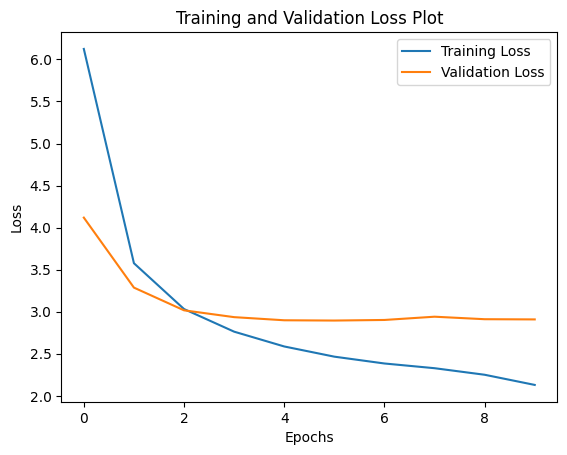

In [55]:
# plot the training and validation loss
plt.plot(loss_plot, label='Training Loss')
plt.plot(val_loss_plot, label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training and Validation Loss Plot')
plt.legend()
plt.show()


In [56]:
# tf.keras.utils.register_keras_serializable("EncoderBlock")(EncoderBlock)
# tf.keras.utils.register_keras_serializable("Encoder")(Encoder)
# tf.keras.utils.register_keras_serializable("DecoderBlock")(DecoderBlock)
# tf.keras.utils.register_keras_serializable("Decoder")(Decoder)

#transformer.save('transformer_model')

In [57]:
# tf.keras.utils.register_keras_serializable("EncoderBlock")(EncoderBlock)
# tf.keras.utils.register_keras_serializable("Encoder")(Encoder)
# tf.keras.utils.register_keras_serializable("DecoderBlock")(DecoderBlock)
# tf.keras.utils.register_keras_serializable("Decoder")(Decoder)


# model = tf.keras.models.load_model('transformer_model')
# model.summary()

In [58]:
# encoder_input = tf.keras.layers.Input(shape=(49, 512))
# decoder_input = tf.keras.layers.Input(shape=(MAX_LENGTH))

# look_ahead_mask = create_look_ahead_mask(tf.shape(decoder_input)[1])
# dec_padding_mask = None     # BUG: can't use padding mask for some unknown reasons.

# predictions, attention_weights = model(input=encoder_input,
#                                             target=decoder_input,
#                                             training=True,
#                                             look_ahead_mask=look_ahead_mask,
#                                             dec_padding_mask=dec_padding_mask)



# 4. Generate captions

## 4.1 Define the function for generating

In [59]:
def evaluate(image):
    # expand the image dimensions to fit the model's expected input
    temp_input = tf.expand_dims(load_image(image)[0], 0)
    # print('input shape before vgg:', temp_input.shape)

    # pass image through the VGG model to obtain feature vectors
    img_tensor_val = vgg_model(temp_input)
    # print('input shape after vgg:', img_tensor_val.shape)

    # reshape the feature vector, flatten the image dimensions
    img_tensor_val = tf.reshape(
        img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))
    # print('encoder input shape:', img_tensor_val.shape)

    # start token for the sequence generation
    decoder_input = tf.expand_dims([word_to_index(SEQ_START)], 0)
    # print('decoder input shape:', decoder_input.shape)

    result = []

    # loop for the max sequence length
    for i in range(MAX_LENGTH):
        # create look ahead mask and padding mask
        look_ahead_mask = create_look_ahead_mask(tf.shape(decoder_input)[1])
        dec_padding_mask = None     # BUG: can't use padding mask for some unknown reasons

        # transformer model to predict the output and attention weights
        predictions, attention_weights = transformer(input=img_tensor_val,
                                                     target=decoder_input,
                                                     training=False,
                                                     look_ahead_mask=look_ahead_mask,
                                                     dec_padding_mask=dec_padding_mask)

        # the last word predicted will be the next input to the transformer
        predictions = predictions[:, -1:, :]  # (batch_size, 1, vocab_size)
        predicted_id = tf.argmax(predictions, axis=-1)

        # if the predicted word is the end token, stop the loop and return
        if predicted_id[0][0].numpy() == word_to_index(SEQ_END):
            return result[:-1], attention_weights

        # convert the predicted id to the word and append to the result
        predicted_word = tf.compat.as_text(index_to_word(predicted_id[0][0].numpy()).numpy())
        result.append(predicted_word)

        # concatenate the predicted word id to the decoder input for the next prediction step
        decoder_input = tf.concat([decoder_input, predicted_id], axis=-1)

    # get the sequence of generated words and the attention weights
    return result, attention_weights


In [60]:
def generate(image_path):

    # if the image path is a URL download the image
    if 'https://' in image_path:
      image_extension = image_path[-4:]

      # assign it to a local variable `image_path`
      image_path = tf.keras.utils.get_file('image' + image_extension, origin=image_path)

    if image_path in all_image_paths:
      # image id
      image_filename = os.path.basename(image_path)
      # construct the image id by appending the ".jpg" extension
      image_id = os.path.splitext(image_filename)[0]+".jpg"

      # retrieve all associated captions for the image from mapping
      all_captions = captions_map[image_id]
      print('---------------Actual Captions:---------------')
      for caption in all_captions:
        print(caption)

    # generate a caption using the evaluate function
    result, _ = evaluate(image_path)
    print('='*50)
    print('Prediction Caption:', ' '.join(result))
    # open the image
    plt.imshow(plt.imread(image_path))
    plt.show()
    # return the predicted caption as a string
    return ' '.join(result)


## 4.2 Generating the caption for 3 images

---------------Actual Captions:---------------
[start] Two black and brown dobermans running in a field playing ball . [end]
[start] Two black and brown dogs are running through a field . [end]
[start] Two doberman 's run through a field while one of them holds a tennis ball in its mouth . [end]
[start] Two dogs run around together in the field . [end]
[start] Two large black dogs , one with a ball in its mouth , are running through tall grass . [end]
Prediction Caption: a black dog is herding sheep through a field


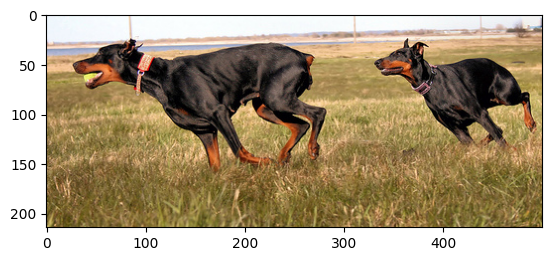

'a black dog is herding sheep through a field'

In [61]:
generate("/content/Flicker8k_Dataset/2439384468_58934deab6.jpg")

---------------Actual Captions:---------------
[start] A brown and white dog is running through the snow . [end]
[start] A dog is running in the snow [end]
[start] A dog running through snow . [end]
[start] a white and brown dog is running through a snow covered field . [end]
[start] The white and brown dog is running over the surface of the snow . [end]
Prediction Caption: a white dog runs through the snow


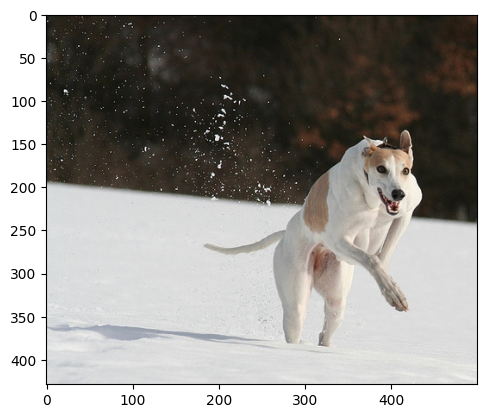

'a white dog runs through the snow'

In [62]:
generate('/content/Flicker8k_Dataset/101654506_8eb26cfb60.jpg')

---------------Actual Captions:---------------
[start] a man looks through his binoculars while another man holds a drink . [end]
[start] A man with a thermos is standing next to a man who is gazing through binoculars . [end]
[start] Two men are standing together while one looks through binoculars . [end]
[start] Two men look out as one is holding binoculars . [end]
[start] two people standing next to each other with mountains in the distance . [end]
Prediction Caption: a man and a woman are looking at each other


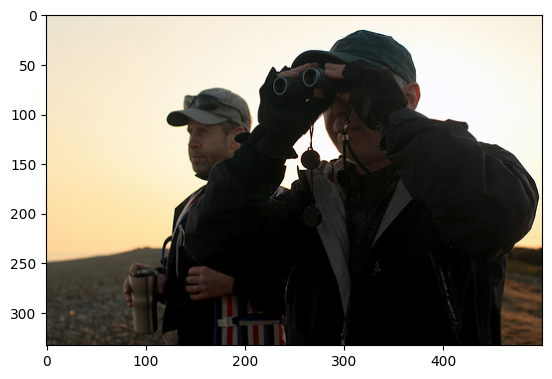

'a man and a woman are looking at each other'

In [63]:
generate('/content/Flicker8k_Dataset/2096771662_984441d20d.jpg')

In [64]:
# # loop through the validation set, skipping every 5 entries to get unique images
# for i in range(0, 15, 5):
#     # call the generate function
#     print(image_val_paths[i])  # Print the image path
#     generate(image_val_paths[i])
#     print('='*50)

# 5. Result validation by BLEU

## 5.1 Caculate BLEU score for 1 result

In [65]:
import nltk
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
from nltk.tokenize import word_tokenize

nltk.download('punkt')

def calculate_bleu(image_path):
    # tokenize
    image_filename = os.path.basename(image_path)
    image_name = os.path.splitext(image_filename)[0]+".jpg"
    true_captions = captions_map[image_name]
    true_captions = [caption.replace('[start]', '').replace(' . [end]', '') for caption in true_captions]  # clean the captions
    predicted_caption = generate(image_path)

    reference_tokens = [word_tokenize(reference) for reference in true_captions]
    generated_tokens = word_tokenize(predicted_caption)

    # use sentence_bleu with smoothing
    smoothing_function = SmoothingFunction().method1
    bleu_score = sentence_bleu(reference_tokens, generated_tokens, smoothing_function=smoothing_function)

    print("BLEU Score:", bleu_score)

    return bleu_score


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


---------------Actual Captions:---------------
[start] a man looks through his binoculars while another man holds a drink . [end]
[start] A man with a thermos is standing next to a man who is gazing through binoculars . [end]
[start] Two men are standing together while one looks through binoculars . [end]
[start] Two men look out as one is holding binoculars . [end]
[start] two people standing next to each other with mountains in the distance . [end]
Prediction Caption: a man and a woman are looking at each other


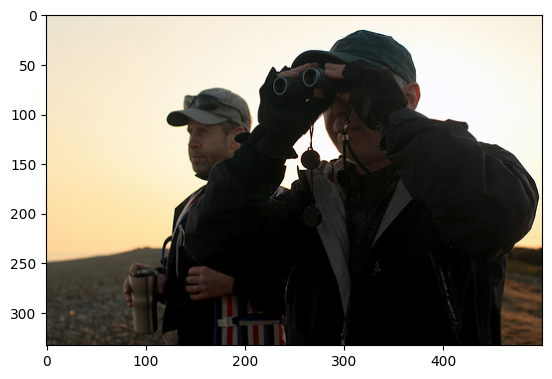

BLEU Score: 0.06985342056580097


0.06985342056580097

In [66]:
calculate_bleu("/content/Flicker8k_Dataset/2096771662_984441d20d.jpg")


---------------Actual Captions:---------------
[start] A brown and white dog is running through the snow . [end]
[start] A dog is running in the snow [end]
[start] A dog running through snow . [end]
[start] a white and brown dog is running through a snow covered field . [end]
[start] The white and brown dog is running over the surface of the snow . [end]
Prediction Caption: a white dog runs through the snow


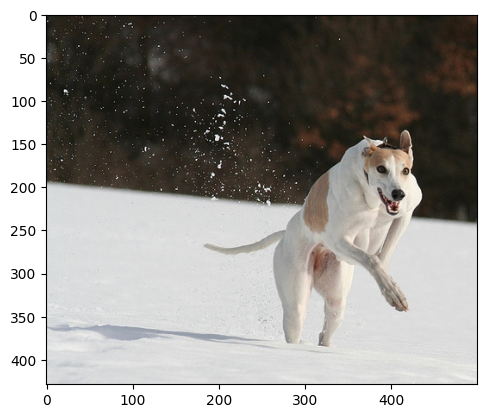

BLEU Score: 0.23119742295813958


0.23119742295813958

In [67]:
calculate_bleu("/content/Flicker8k_Dataset/101654506_8eb26cfb60.jpg")

---------------Actual Captions:---------------
[start] Two black and brown dobermans running in a field playing ball . [end]
[start] Two black and brown dogs are running through a field . [end]
[start] Two doberman 's run through a field while one of them holds a tennis ball in its mouth . [end]
[start] Two dogs run around together in the field . [end]
[start] Two large black dogs , one with a ball in its mouth , are running through tall grass . [end]
Prediction Caption: a black dog is herding sheep through a field


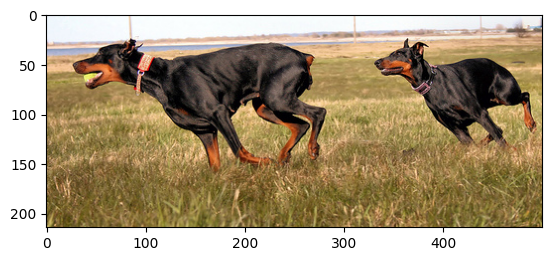

BLEU Score: 0.13485111859503685


0.13485111859503685

In [68]:
calculate_bleu("/content/Flicker8k_Dataset/2439384468_58934deab6.jpg")


## 5.2 Look at BLEU scores for the 20 validation image-captions


---------------Actual Captions:---------------
[start] A man and two youngsters are standing in front of a Japanese vending machine . [end]
[start] Family purchasing standing at a vending machine . [end]
[start] Three people stand and face video machines . [end]
[start] Three people stand near a couple of machines , one labeled Sharp . [end]
[start] Two kids and a man play games at an arcade . [end]
Prediction Caption: a man stands in front of a bus


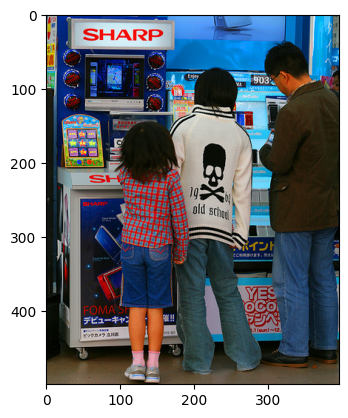

BLEU Score: 0.392814650900513
---------------Actual Captions:---------------
[start] A little boy walks with a woman wearing red in a wheelchair . [end]
[start] a toddler in a green and yellow jersey is being followed by a wheelchair bound woman in a red sweater past a wooden bench . [end]
[start] A woman in a wheelchair and a toddler at a park . [end]
[start] A woman in a wheelchair and orange sweater follows a young boy in a park . [end]
[start] A woman in a wheelchair follows a young boy at a park . [end]
Prediction Caption: a man is riding a bicycle down a sidewalk


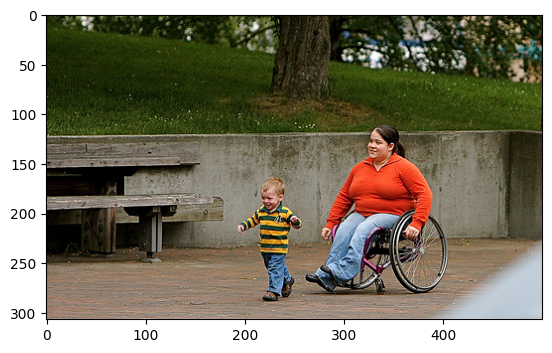

BLEU Score: 0.027155616465759737
---------------Actual Captions:---------------
[start] a boy performs a stunt on a BMX bike . [end]
[start] A man does a bicycle trick on a concrete obstacle . [end]
[start] a man doing tricks on a bmx bike [end]
[start] An extreme bicyclist is performing a jump with his bicycle and rotating the bicycle while he is in the air . [end]
[start] Person doing a trick bike move in a skatepark . [end]
Prediction Caption: a man is doing a trick on a bicycle


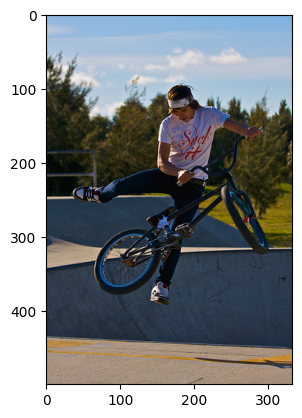

BLEU Score: 0.24446151121745052
---------------Actual Captions:---------------
[start] a boy in a blue top is jumping off some rocks in the woods . [end]
[start] A boy jumps off a tan rock . [end]
[start] A boy jumps up in a field in the woods . [end]
[start] A young boy jumps off a rock in the forest [end]
[start] Child in blue and grey shirt jumping off hill in the woods [end]
Prediction Caption: a boy in a black shirt and a helmet is jumping a rock


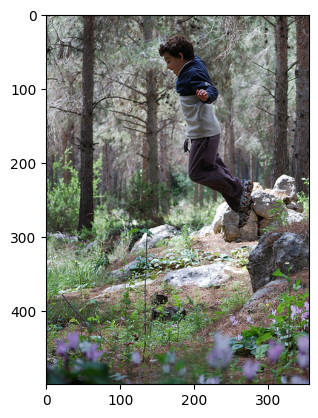

BLEU Score: 0.2691109110344472
---------------Actual Captions:---------------
[start] A group of elephants are being ridden by men . [end]
[start] Five men dressed in white ride on elephants that are painted with bright colors . [end]
[start] Five men wearing turbans are riding on elephants a far eastern city street . [end]
[start] Four men wearing turbans wait to give elephant rides to people . [end]
[start] Several men riding elephants through the street . [end]
Prediction Caption: a man is standing in front of a large brown dog that is standing on a dirt road


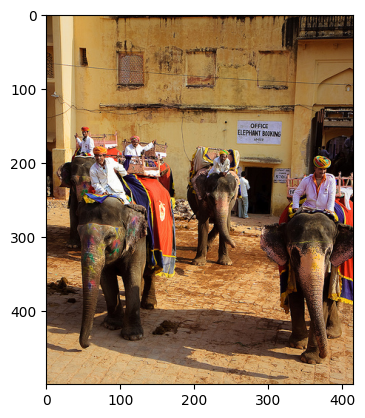

BLEU Score: 0.016153228406487214
---------------Actual Captions:---------------
[start] An adult and a child sitting down and both are biting their finger nails . [end]
[start] An older woman sits next to a small girl who is wearing a striped dress . [end]
[start] An old woman is sitting next to a young girl with her fingers in her mouth . [end]
[start] An old woman with a big bag in her lap sits next to a little girl in a stripe , orange dress . [end]
[start] A young girl with two fingers in her mouth sitting next to an older woman . [end]
Prediction Caption: a man and a woman pose for a picture


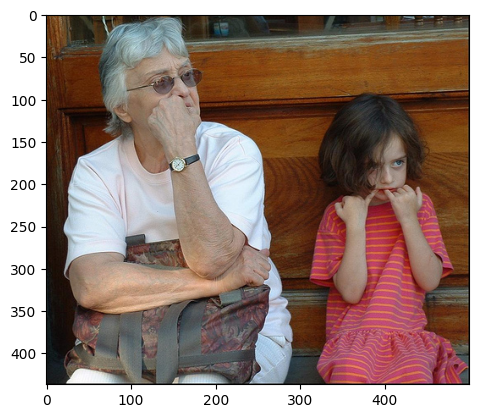

BLEU Score: 0.03658662442386339
---------------Actual Captions:---------------
[start] A closeup of a teenage girl wearing red beads . [end]
[start] A girl with a Gonzaga sweatshirt and red beads smiles . [end]
[start] a teenager is wearing a grey hooded top and some red beads around her neck . [end]
[start] A young woman with light brown hair wearing a red beaded neclace , a Gonzaga sweatshirt and earrings stands smiling . [end]
[start] Young blond woman with red beads , gray sweatshirt marked GONTAGA . [end]
Prediction Caption: a girl with a black jacket is looking at something in his hand


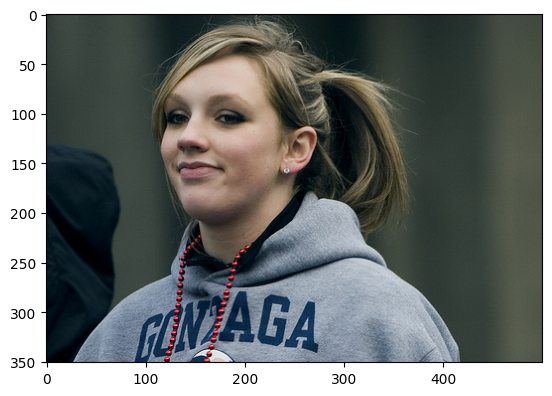

BLEU Score: 0.08737167851715875
---------------Actual Captions:---------------
[start] A black sheep with three white dogs . [end]
[start] four white dogs are standing beside a black sheep . [end]
[start] The white dogs look curiously at the black llama . [end]
[start] Three white dogs are near a black llama . [end]
[start] White dogs stand near a sheep or llama . [end]
Prediction Caption: a white dog sniffing sheep on a dirt track


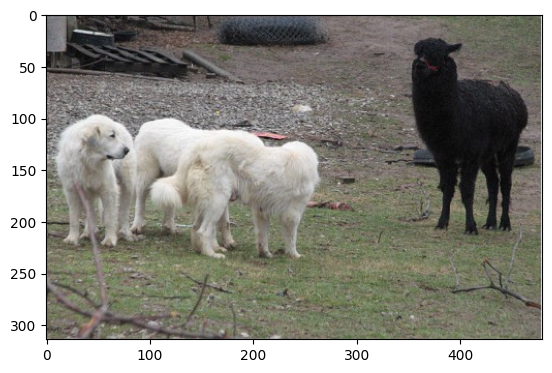

BLEU Score: 0.03155984539112946
---------------Actual Captions:---------------
[start] A black puppy is biting a tree limb . [end]
[start] A brown puppy chewing on a tree branch . [end]
[start] A puppy dog is playing with a branch . [end]
[start] A puppy is gnawing on a plant branch in an uncut grassy area with wood and a barrel nearby . [end]
[start] A young brown puppy pulls a leafy branch in his teeth in a backyard . [end]
Prediction Caption: a brown dog is yawning


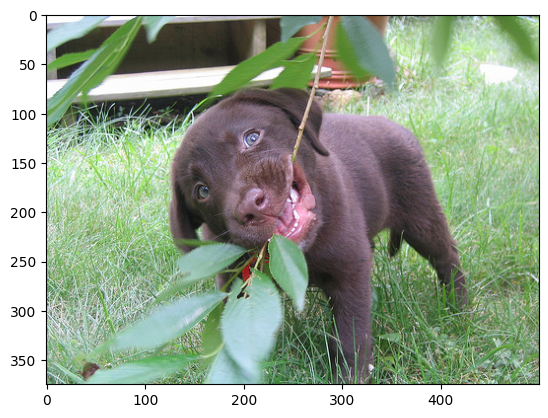

BLEU Score: 0.07415543676501504
---------------Actual Captions:---------------
[start] a boy in green shorts swims past a boy in black shorts in an outdoor pool . [end]
[start] Two boys swim on a sunny day . [end]
[start] Two children swimming in green water . [end]
[start] Two young boys swim and play in an outdoor fountain . [end]
[start] Two young boys swimming in a pool of green water . [end]
Prediction Caption: a boy in a red shirt is playing in a river


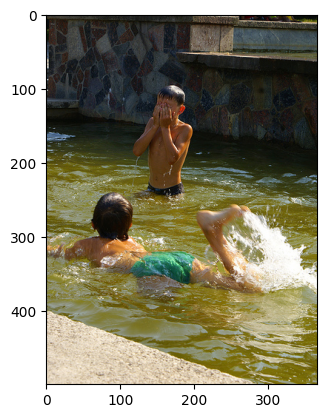

BLEU Score: 0.11731175160264001
---------------Actual Captions:---------------
[start] A man with red shirt and black hat stares at another man . [end]
[start] Asian man in red flowered shirt and hat in discussion with two other men [end]
[start] Talk between man in Hawaiian shirt , older man in gray and man seen from behind . [end]
[start] These three men are sitting near each other , and are all wearing short sleeved shirts . [end]
[start] Three men , one in a red and white shirt , are sitting together . [end]
Prediction Caption: a boy in a red shirt and a red shirt is sitting on a wooden bench


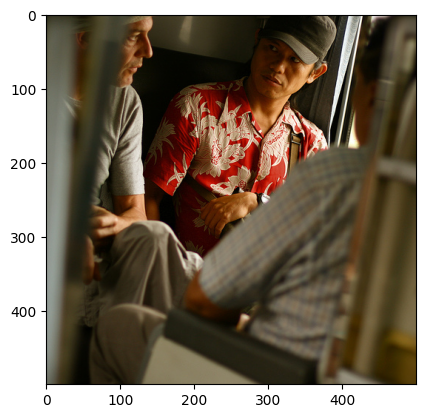

BLEU Score: 0.1023857820560022
---------------Actual Captions:---------------
[start] A group of men in green shirts and black pants holding hands [end]
[start] Black people dancing in a Boston square . [end]
[start] Four men posing on the street in green shirts and black pants . [end]
[start] Several men in matching green and black outfits in front of a monument . [end]
[start] Three men wearing green t-shirts do a street performance . [end]
Prediction Caption: four children are playing in a park


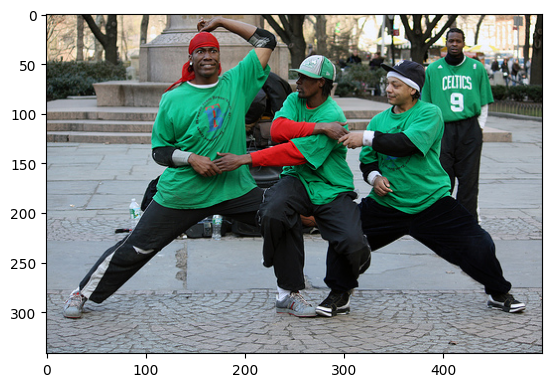

BLEU Score: 0.06985342056580097
---------------Actual Captions:---------------
[start] Three children are riding down a hill on tricycles in their winter coats . [end]
[start] Three children are riding tricycles on the path . [end]
[start] three children ride three wheelers . [end]
[start] Three kids ride their tricycles down the street . [end]
[start] Three little kids on tricycles race downhill . [end]
Prediction Caption: two young boys play with a toy car


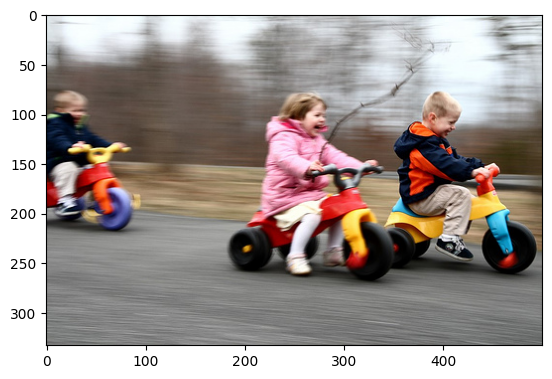

BLEU Score: 0.02777619034011792
---------------Actual Captions:---------------
[start] A group of girls wearing costumes stand in a park . [end]
[start] A group of girls who are gothically dressed standing together [end]
[start] A group of people in anime cosplay costumes . [end]
[start] A group of three females and one male dressed in costume [end]
[start] Three women are dressed in costumes while one holds an umbrella . [end]
Prediction Caption: a group of women in skirts are standing in front of a group of people


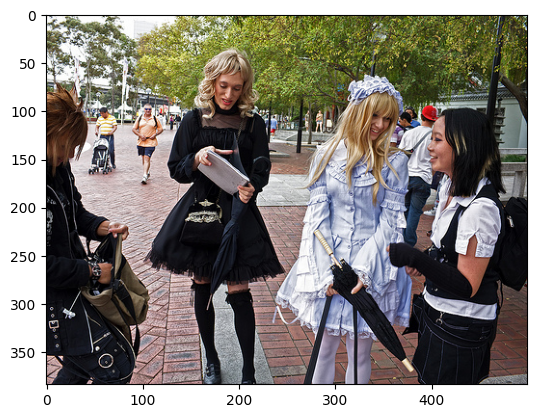

BLEU Score: 0.08359764098433711
---------------Actual Captions:---------------
[start] a band performs . [end]
[start] A blonde woman stands behind a microphone . [end]
[start] An old woman singing and playing music . [end]
[start] A woman playing guitar and singing in the foreground and three others performing behind her . [end]
[start] A woman singing and playing an acoustic guitar and three people accompanying her . [end]
Prediction Caption: a group of women are playing a game


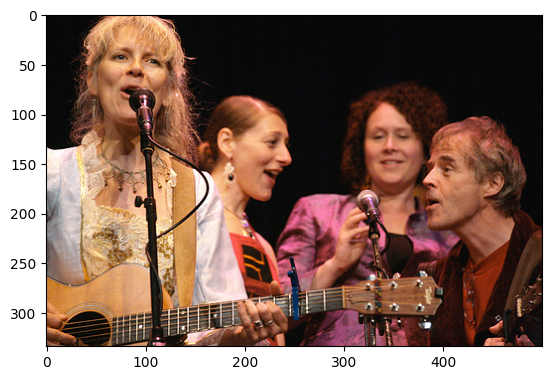

BLEU Score: 0.03303164318013808
---------------Actual Captions:---------------
[start] a boy in a green shirt is jumping with his arms in the air at the end of a bowling alley . [end]
[start] A boy wearing a green shirt is jumping in front of a lane at a bowling alley . [end]
[start] A child jumps in the air at a bowling alley . [end]
[start] A young boy with a Mohawk and green shirt is excited about bowling . [end]
[start] A young boy with a Mohawk jumping at a bowling alley [end]
Prediction Caption: a boy in a green shirt and blue pants is playing with a toy


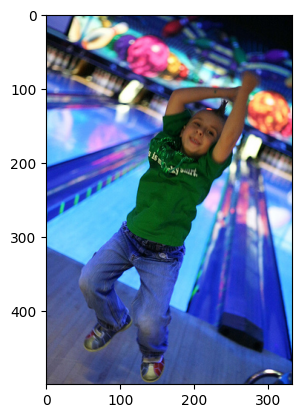

BLEU Score: 0.4160751652217845
---------------Actual Captions:---------------
[start] A black and brown dog has rope in its mouth . [end]
[start] A dog jumps to catch a rope toy . [end]
[start] A dog with a rope toy in its mouth runs on the grass . [end]
[start] A large dog is running on the grass with a rope in its mouth . [end]
[start] The dog is running with a rope toy . [end]
Prediction Caption: a black dog is chasing a brown dog across the grass


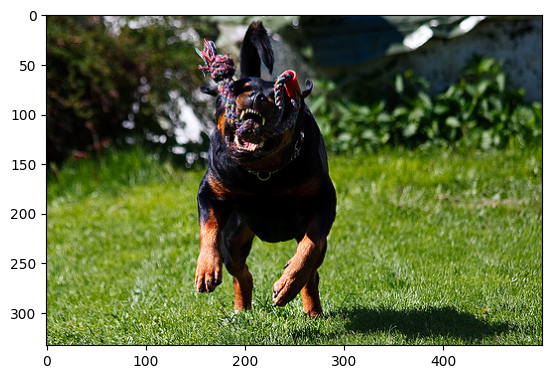

BLEU Score: 0.07175852914772135
---------------Actual Captions:---------------
[start] A man drives a boat along a waterway lined with apartments . [end]
[start] a man driving a blue boat passes by some colorful houses . [end]
[start] A man steers a boat through the canal lined with colorful houses with red roofs . [end]
[start] A man steers a blue boat past brightly colored houses . [end]
[start] A person on a boat in a canal . [end]
Prediction Caption: a man is climbing a rock wall


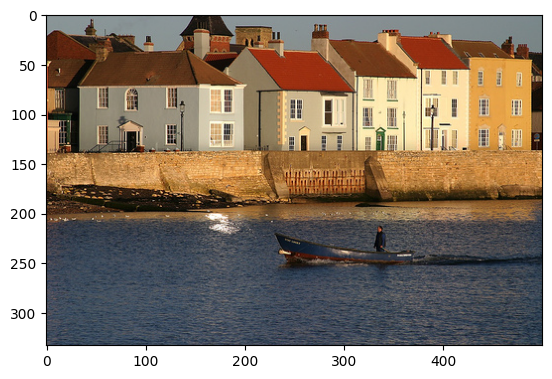

BLEU Score: 0.0670144447096575
---------------Actual Captions:---------------
[start] A man jet boarding . [end]
[start] A parasurfer is airborne over the water . [end]
[start] A wakeboarder is attempting a trick while holding on to lines pointed upward . [end]
[start] A wakeboarder is jumping a huge wave . [end]
[start] person on a wakeboard in the air [end]
Prediction Caption: a surfer rides a wave


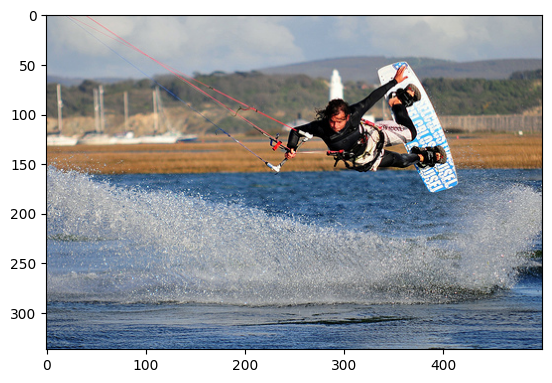

BLEU Score: 0.06389431042462725
---------------Actual Captions:---------------
[start] A white and a white dog are fighting over a stick in the water . [end]
[start] Two dogs are playing with a stick in a lake . [end]
[start] Two dogs in the water fight over a stick . [end]
[start] Two dogs playing in the water with a stick [end]
[start] Two dogs playing with a stick in shallow water . [end]
Prediction Caption: two dogs run through the water


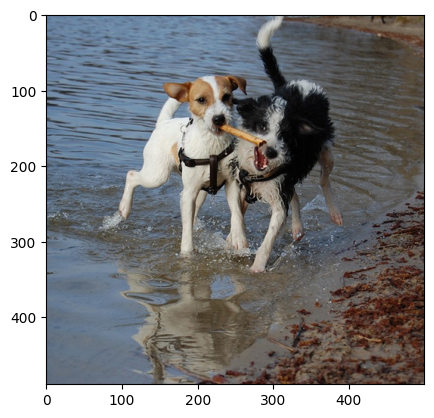

BLEU Score: 0.05795053470733952


In [69]:
# delect every 5th image path to get unique images
unique_val_images = image_val_paths[::5][:20]

bleu_scores = []

# calculate BLEU scores for these images
for image_path in (unique_val_images):
    bleu_score = calculate_bleu(image_path)
    bleu_scores.append(bleu_score)


## 5.3 Caculate BLEU score for the whole validation set, measure the model's performance


In [70]:
def generate_no_print(image_path):
    image_filename = os.path.basename(image_path)
    image_id = os.path.splitext(image_filename)[0]+".jpg"
    result, _ = evaluate(image_path)
    generated_caption = ' '.join(result)
    return generated_caption


def calculate_bleu_no_print(image_path):
    # get true and predicted captions
    image_filename = os.path.basename(image_path)
    image_name = os.path.splitext(image_filename)[0]+".jpg"
    true_captions = captions_map[image_name]
    true_captions = [caption.replace('[start]', '').replace(' . [end]', '') for caption in true_captions]  # clean the captions
    predicted_caption = generate_no_print(image_path)

    # tokenize
    reference_tokens = [word_tokenize(reference) for reference in true_captions]
    generated_tokens = word_tokenize(predicted_caption)

    # use sentence_bleu with smoothing
    smoothing_function = SmoothingFunction().method1
    bleu_score = sentence_bleu(reference_tokens, generated_tokens, smoothing_function=smoothing_function)

    return bleu_score


In [71]:
# displaying progress bars in loops
from tqdm import tqdm

# get a set of unique image paths
unique_image_val_paths = set(image_val_paths)
bleu_scores = []

# loop through each unique image path
for image_path in tqdm(unique_image_val_paths, desc="Calculating BLEU Scores"):
    bleu_scores.append(calculate_bleu_no_print(image_path))

Calculating BLEU Scores: 100%|██████████| 1619/1619 [24:27<00:00,  1.10it/s]


In [72]:
# get the max, min, and avg BLEU scores in the validation set
print("Max BLEU score: ", max(bleu_scores))
print("Min BLEU score: ", min(bleu_scores))
print("Average BLEU score: ", sum(bleu_scores)/len(bleu_scores))

Max BLEU score:  0.8891397050194614
Min BLEU score:  0
Average BLEU score:  0.11512883431184752


# 6. Prediction

In [73]:
# !pip install gdown

In [74]:
# download files/folders from Google Drive
!gdown --folder https://drive.google.com/drive/folders/1Dx57GkBtIu0rxmquViFzeXJ8HuGxjEuF?usp=sharing

Retrieving folder list
Processing file 1CWnhCZszEmZfwstCaybaZlHyixd6upk4 WX20231205-231535@2x.png
Processing file 192xzd-qVGX8KcNS5YyTOYdddZBuqxQPH WX20231205-231628@2x.png
Processing file 1Q7lbqYDWJYMwUnePgZTEzH3r8AtWXzx4 WX20231205-231649@2x.png
Processing file 1ChSSbTjclwjtN0rYjbBUgHXY-PcM-bDw WX20231205-231727@2x.png
Processing file 1JmSX9CWhtQ5hqqdXVyJAOgQ0ZCLPr66a WX20231205-231801@2x.png
Processing file 1AhG7P_hskZ_p60NzTJ17CO2lyRmrAf4s WX20231205-231816@2x.png
Processing file 1jJSt5sjwFicOWhoBoO2m-qU4baELccC0 WX20231205-231849@2x.png
Processing file 1cKFvU4mqVOxSL73-sQsYzM7Ig97eRHPB WX20231205-231905@2x.png
Processing file 1fINxOGP3USuUJKx0hu-TQgTgP7jK07Nk WX20231205-231942@2x.png
Processing file 1cSQIHlNzPL5MjxMy6gWbZv3s_Eff6eB5 WX20231206-015316@2x.png
Processing file 1Vn4sNLV5AcEJlgCSXrH6fQXKtdb1WJ6M WX20231206-015338@2x.png
Processing file 1WGvtBXXLbpktOPMpG0UIIQWCIwSkzcSy WX20231206-015754@2x.png
Processing file 1Xyhf2egApvRK6IQ_EWff_Ey8vDyr4_Ap WX20231206-015810@2x.png
Pr

Prediction Caption: a group of young boys are walking down the sidewalk


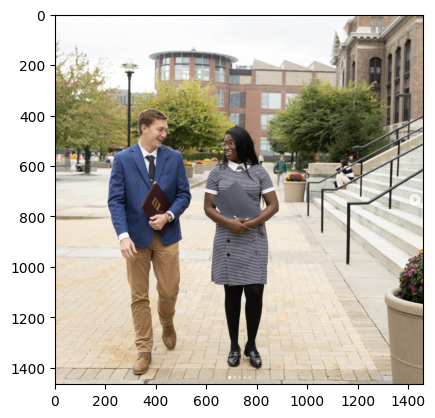

Prediction Caption: a boy in a red shirt and blue jeans is running through a park


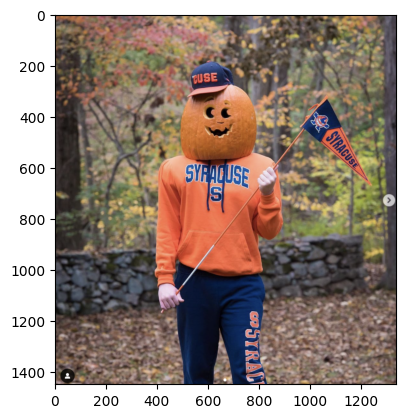

Prediction Caption: a group of dogs are running around a park


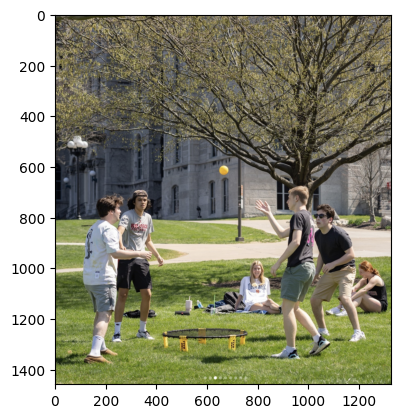

Prediction Caption: a group of people are walking around a pole in front of a building


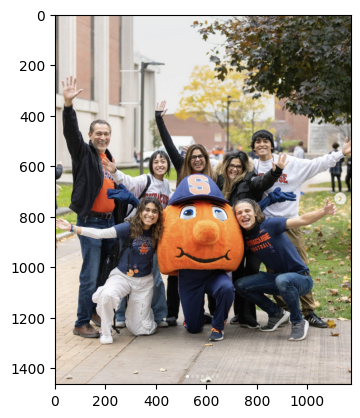

Prediction Caption: two men stand on a street with a red and white dog on it


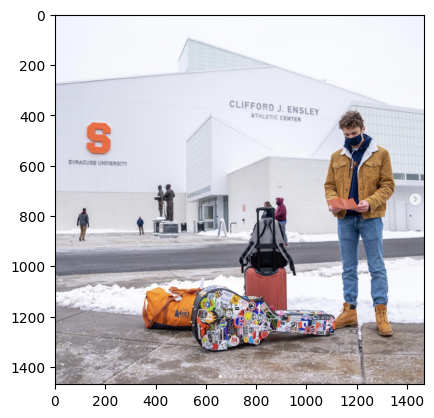

Prediction Caption: a white dog is chewing on a red harness


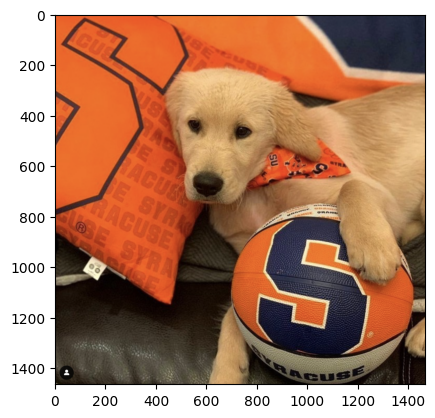

Prediction Caption: a man and a woman looking at each other


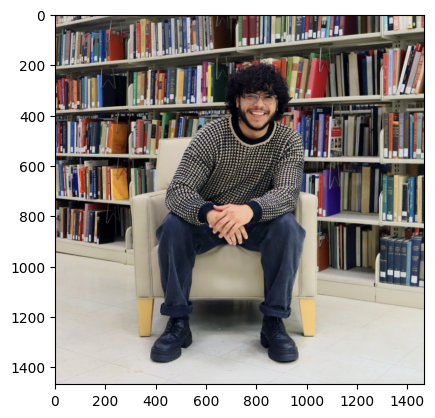

Prediction Caption: a boy is playing with a fountain


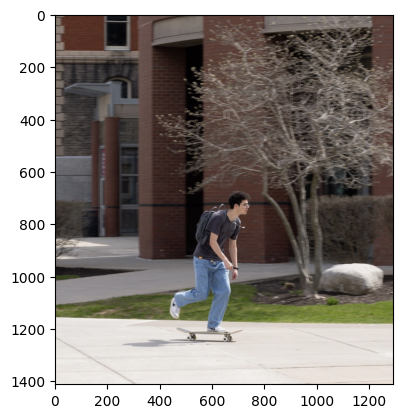

Prediction Caption: two women walking next to a stone wall


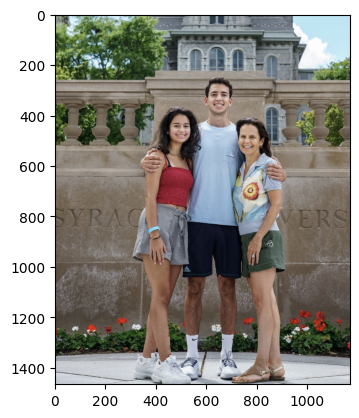

Prediction Caption: a brown dog is chasing a red toy


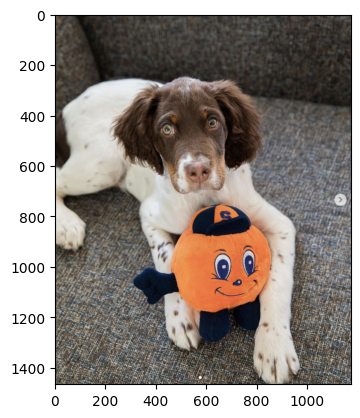

Prediction Caption: a small dog jumping on a red couch


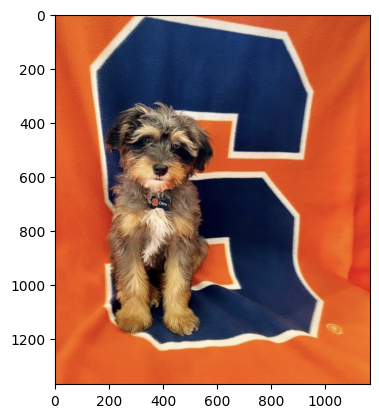

Prediction Caption: a child in a yellow jacket is standing in the snow


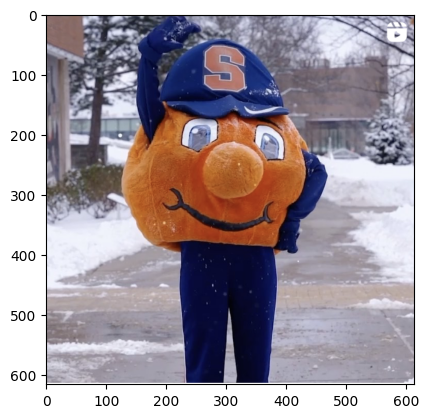

Prediction Caption: a man in a black shirt stands next to a red building


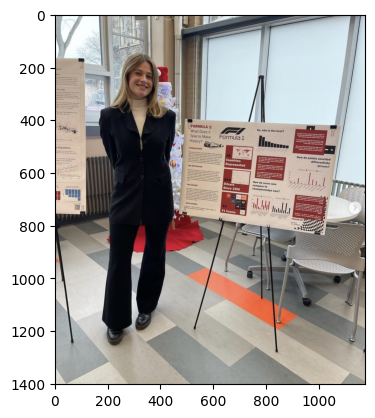

Prediction Caption: a man is holding a knife on his arm and another man 's hand


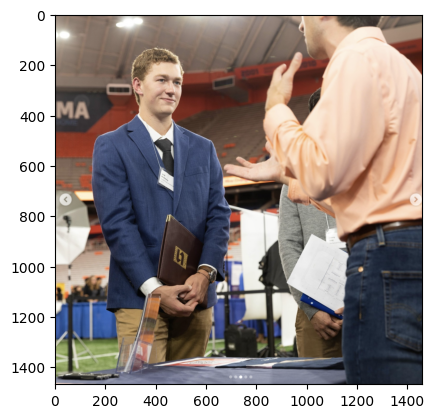

Prediction Caption: a man stands on a bridge looking at a city skyline


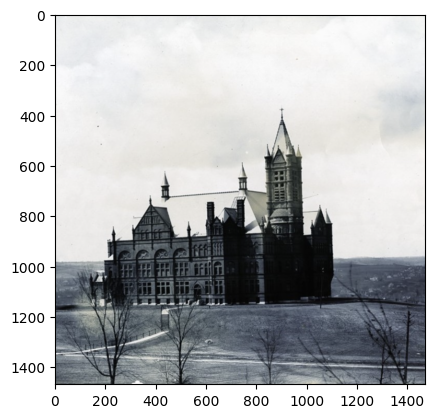

Prediction Caption: a girl in a pink shirt is playing a guitar


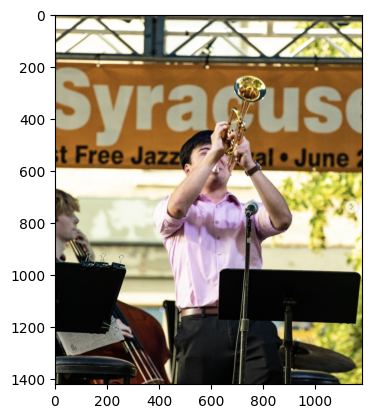

Prediction Caption: a little boy in orange is standing on a motorcycle in front of a set of a set of ice rink


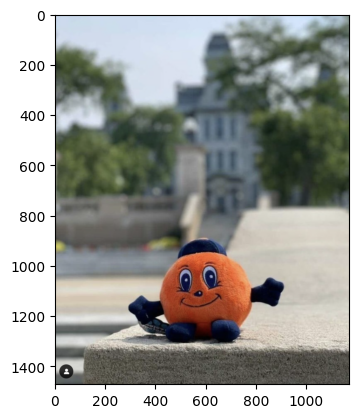

Prediction Caption: a man is surfing a large wave


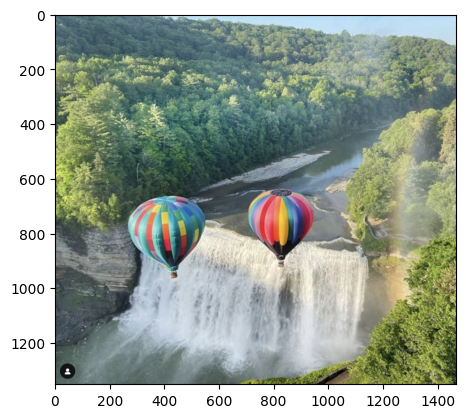

Prediction Caption: a dog jumps over a wooden bench


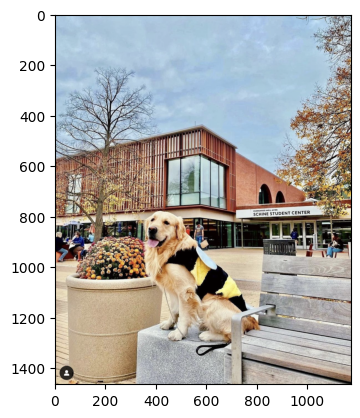

Prediction Caption: a boy in a white shirt and blue jeans is playing on a swing set


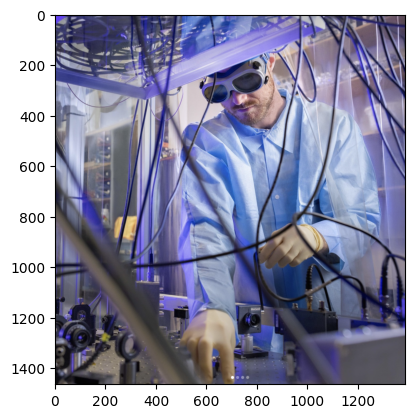

Prediction Caption: a small dog is jumping on a bed with a red ball in its mouth


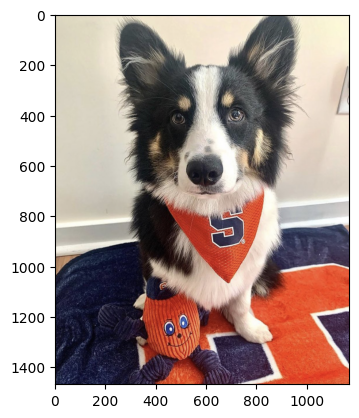

Prediction Caption: a dog is running on a sidewalk with a man in a red shirt


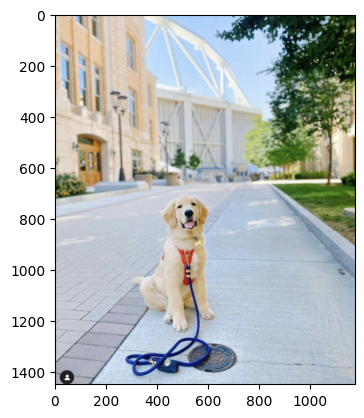

Prediction Caption: a man in a red shirt is looking at something in his hand


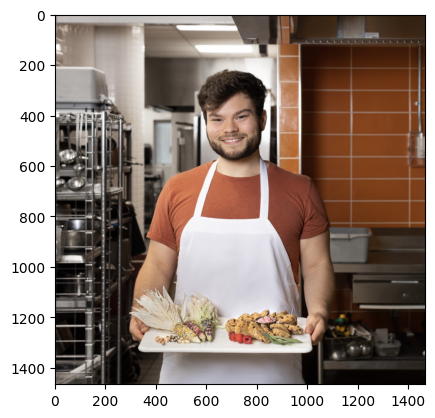

Prediction Caption: a group of people are standing in front of a large crowd


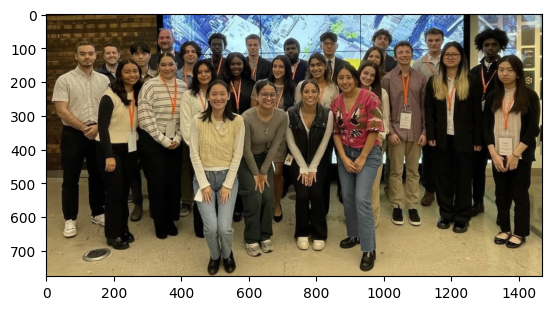

Prediction Caption: a man and woman looking at pictures on a computer


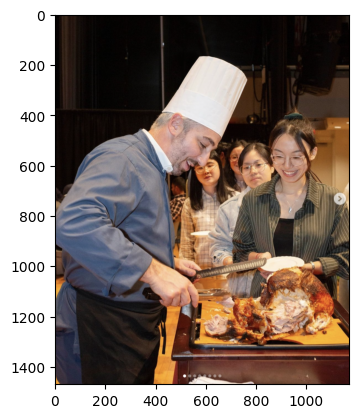

Prediction Caption: a small dog jumps over a pole


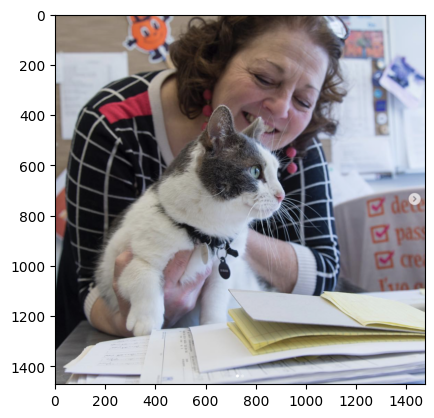

Prediction Caption: a child in a yellow coat is standing in front of a statue


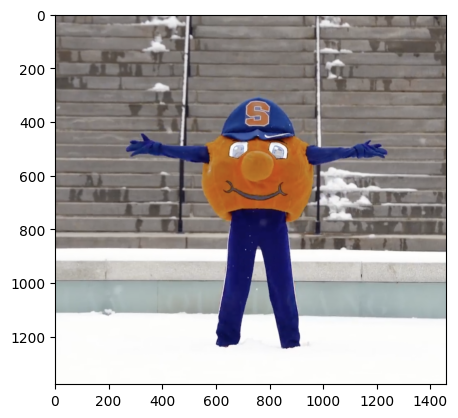

In [75]:
# define the directory containing test images
test_img_dir = '/content/test_img'

# list all files in the directory
image_files = [os.path.join(test_img_dir, file) for file in os.listdir(test_img_dir) if file.endswith(('.png', '.jpg', '.jpeg'))]

# apply the generate function to each image
for image_path in image_files:
    generate(image_path)
